In [ ]:
fig = px.histogram(
    skincare_reviews_all,
    x='average_sentiment',
    nbins=30,
    title='Distribution of Average Sentiment Scores',
    labels={'average_sentiment': 'Average Sentiment Score'}
)
fig.show()

In [ ]:
# Average Product type analysis by Price Intervals
# Define price bins and labels
bins = [0, 10, 20, 30, 40, float('inf')]
labels = ['$0-10', '$10-20', '$20-30', '$30-40', '$50+']

# Create a new column for price intervals
skincare_reviews_all['price_interval'] = pd.cut(skincare_reviews_all['price_usd'], bins=bins, labels=labels, right=False)

# Calculate average sentiment for each price interval and product type
average_sentiment_by_price_and_type = skincare_reviews_all.groupby(['price_interval', 'product_type'])['sentiment'].mean().reset_index()

# Create the bar chart
fig = px.bar(
    average_sentiment_by_price_and_type,
    x='price_interval',
    y='sentiment',
    color='product_type',  # Color by product type
    title='Average Product Type Sentiment by Price',
    labels={'sentiment': 'Average Sentiment Score', 'price_interval': 'Price'},
    barmode='group'  # Group bars for different product types
)

fig.show()

In [ ]:
# Calculate the 75th percentile of Price within each type of product to get a threshold for what we call a "Luxury" item
# If a product's price is at or above the 75th percentile, it will be classified as luxury

#price_thresholds = skincare_reviews_all.groupby('product_type')['price_usd'].quantile(0.75).reset_index()
#price_thresholds.columns = ['product_type', 'luxury_threshold']

# Merge thresholds back to the original DataFrame
#skincare_reviews_all = skincare_reviews_all.merge(price_thresholds, on='product_type', how='left')

# Classify products as Luxury or Non-Luxury
#skincare_reviews_all['luxury_status'] = skincare_reviews_all.apply(
    #lambda row: 'Luxury' if row['price_usd'] >= row['luxury_threshold'] else 'Non-Luxury', axis=1
#)

In [ ]:
# Calculate average sentiment by luxury status and product type
average_sentiment = skincare_reviews_all.groupby(['product_type', 'luxury_status'])['average_sentiment'].mean().reset_index()

In [ ]:
# Create a bar chart for average sentiment
fig = px.bar(
    average_sentiment,
    x='product_type',
    y='average_sentiment',
    color='luxury_status',
    title='Average Sentiment: Luxury vs Non-Luxury Products by Type',
    labels={'average_sentiment': 'Average Sentiment Score', 'product_type': 'Product Type'},
    barmode='group'
)

fig.show()

In [ ]:
# Calculate average sentiment by brand
average_sentiment_by_brand = skincare_reviews_all.groupby('brand_name')['average_sentiment'].mean().reset_index()

# Get top 10 brands with the highest average sentiment
top_brands = average_sentiment_by_brand.nlargest(10, 'average_sentiment')

In [ ]:
# Create a bar chart for the top brands by average sentiment
fig = px.bar(
    top_brands,
    x='brand_name',
    y='average_sentiment',
    title='Top 10 Brands by Average Sentiment',
    labels={'average_sentiment': 'Average Sentiment Score', 'brand_name': 'Brand'},
    color='average_sentiment',
    color_continuous_scale='Blues'
)

fig.show()

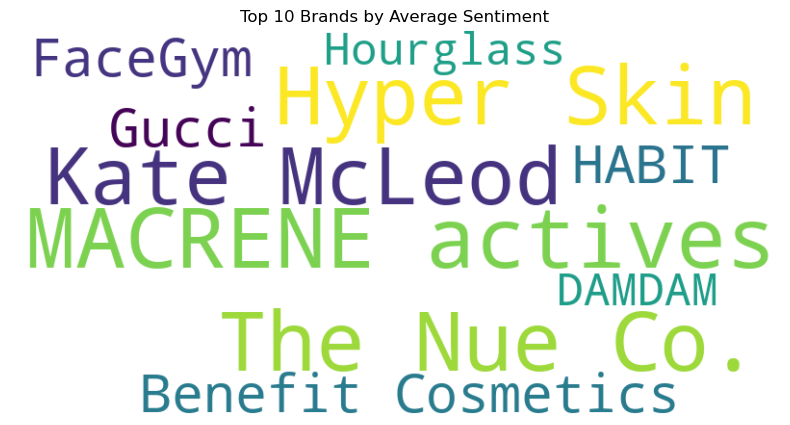

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Create a word cloud based on top brands and their sentiment averages
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(
    dict(zip(top_brands['brand_name'], top_brands['average_sentiment']))
)

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Top 10 Brands by Average Sentiment')
plt.show()

In [ ]:
# Calculate average sentiment by brand and luxury status
average_sentiment_by_brand_luxury = skincare_reviews_all.groupby(['brand_name', 'luxury_status'])['average_sentiment'].mean().reset_index()


In [ ]:
# Get the top 10 brands by average sentiment score
top_10_brands = average_sentiment_by_brand_luxury.groupby('brand_name')['average_sentiment'].mean().nlargest(10).index

# Filter the original DataFrame to include only these top 10 brands
top_10_sentiment = average_sentiment_by_brand_luxury[average_sentiment_by_brand_luxury['brand_name'].isin(top_10_brands)]


In [ ]:
import plotly.express as px

# Create a bar chart for average sentiment of top 10 brands by luxury status
fig = px.bar(
    top_10_sentiment,
    x='brand_name',
    y='average_sentiment',
    color='luxury_status',
    title='Top 10 Brands by Average Sentiment: Luxury vs Non-Luxury',
    labels={'average_sentiment': 'Average Sentiment Score', 'brand_name': 'Brand'},
    barmode='group',  # Group bars for luxury and non-luxury
)

fig.show()
